## IOWA UNIVERSITY https://mesonet.agron.iastate.edu/request/download.phtml?network=ES__ASOS

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
#@title Get metar
station = "LEST" #@param {type:"string"}
from_year = "2018" #@param {type:"string"}
from_month = "01" #@param {type:"string"}
from_day = "01" #@param {type:"string"}
to_year = "2022" #@param {type:"string"}
to_month = "12" #@param {type:"string"}
to_day = "31" #@param {type:"string"}

import pandas as pd
import numpy as np

s1="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station="
OACI=station
#s2="&data=drct&data=sknt"
s2="&data=all"
s3="&year1="+from_year+"&month1="+from_month+"&day1="+from_day
s4="&year2="+to_year+"&month2="+to_month+"&day2="+to_day
s5="&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=M&trace=T&direct=no&report_type=1&report_type=2"
url=s1+OACI+s2+s3+s4+s5
df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)
df

/usr/local/lib/python3.9/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning: Columns (4,10,27) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,station,time,tmpf,dwpf,relh,drct,sknt,p01i,alti,mslp,...,wxcodes,ice_accretion_1hr,ice_accretion_3hr,ice_accretion_6hr,peak_wind_gust,peak_wind_drct,peak_wind_time,feel,metar,snowdepth
0,LEST,2018-01-01 00:00:00,48.2,46.4,93.45,230.00,9.0,0.0,30.39,M,...,M,M,M,M,M,M,M,43.66,LEST 010000Z 23009KT 200V280 9999 FEW020 SCT03...,M
1,LEST,2018-01-01 00:30:00,48.2,44.6,87.28,220.00,9.0,0.0,30.36,M,...,M,M,M,M,M,M,M,43.66,LEST 010030Z 22009KT 200V260 9999 FEW020 SCT03...,M
2,LEST,2018-01-01 01:00:00,50.0,44.6,81.61,230.00,9.0,0.0,30.36,M,...,M,M,M,M,M,M,M,45.90,LEST 010100Z 23009KT 190V260 9999 FEW020 BKN04...,M
3,LEST,2018-01-01 01:30:00,50.0,46.4,87.37,220.00,9.0,0.0,30.36,M,...,M,M,M,M,M,M,M,45.90,LEST 010130Z 22009KT 190V280 9999 FEW019 SCT04...,M
4,LEST,2018-01-01 02:00:00,50.0,46.4,87.37,230.00,9.0,0.0,30.36,M,...,M,M,M,M,M,M,M,45.90,LEST 010200Z 23009G21KT 180V290 9999 SCT015 SC...,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90838,LEST,2022-12-30 21:30:00,57.2,53.6,87.74,210.00,21.0,0.0,29.97,M,...,M,M,M,M,M,M,M,57.2,LEST 302130Z 21021G35KT 170V260 9999 BKN018 14...,M
90839,LEST,2022-12-30 22:00:00,59.0,51.8,76.98,210.00,22.0,0.0,29.97,M,...,M,M,M,M,M,M,M,59.0,LEST 302200Z 21022G38KT 180V260 9999 BKN020 15...,M
90840,LEST,2022-12-30 22:30:00,57.2,51.8,82.12,200.00,19.0,0.0,30.00,M,...,M,M,M,M,M,M,M,57.2,LEST 302230Z 20019G33KT 170V260 9999 BKN018 14...,M
90841,LEST,2022-12-30 23:00:00,57.2,53.6,87.74,210.00,18.0,0.0,30.00,M,...,-RA,M,M,M,M,M,M,57.2,LEST 302300Z 21018G30KT 160V260 9999 -RA BKN01...,M


In [ ]:
!pip install klib
import klib

In [2]:
df.columns

Index(['station', 'time', 'tmpf', 'dwpf', 'relh', 'drct', 'sknt', 'p01i',
       'alti', 'mslp', 'vsby', 'gust', 'skyc1', 'skyc2', 'skyc3', 'skyc4',
       'skyl1', 'skyl2', 'skyl3', 'skyl4', 'wxcodes', 'ice_accretion_1hr',
       'ice_accretion_3hr', 'ice_accretion_6hr', 'peak_wind_gust',
       'peak_wind_drct', 'peak_wind_time', 'feel', 'metar', 'snowdepth'],
      dtype='object')

In [ ]:
#today metar
from datetime import timedelta
today=pd.to_datetime("today")
# today 
OACI="LEST"

#url string
s1="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station="
s2="&data=all"
s3="&year1="+today.strftime("%Y")+"&month1="+today.strftime("%m")+"&day1="+today.strftime("%d")
s4="&year2="+today.strftime("%Y")+"&month2="+today.strftime("%m")+"&day2="+today.strftime("%d")
s5="&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=M&trace=T&direct=no&report_type=1&report_type=2"
url=s1+OACI+s2+s3+s4+s5
df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)
df[["time","metar"]].set_index("time")

,metar
time,
2021-06-25 00:00:00,LEVX 250000Z 03003KT CAVOK 19/12 Q1020 NOSIG
2021-06-25 00:30:00,LEVX 250030Z VRB02KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 01:00:00,LEVX 250100Z 00000KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 01:30:00,LEVX 250130Z 23004KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 02:00:00,LEVX 250200Z 24003KT 200V280 CAVOK 18/13 Q1019...
2021-06-25 02:30:00,LEVX 250230Z 24006KT CAVOK 18/13 Q1019 NOSIG
2021-06-25 03:00:00,LEVX 250300Z 23005KT 200V280 CAVOK 17/13 Q1019...
2021-06-25 03:30:00,LEVX 250330Z 25005KT 180V280 CAVOK 17/13 Q1019...
2021-06-25 04:00:00,LEVX 250400Z 24005KT 210V280 CAVOK 16/13 Q1019...


In [3]:
#temperature  dry and dew to Kelvin scale. Fixing errors
df["temp_o"]= round(((pd.to_numeric(df["tmpf"], downcast="float",errors='coerce'))-32)*(5/9)+273.15,0)
df["tempd_o"]=round(((pd.to_numeric(df["dwpf"], downcast="float",errors='coerce'))-32)*(5/9)+273.15,0)
df.loc[df.temp_o>320,"temp_o"]=np.nan
df.loc[df.tempd_o<260,"tempd_o"]=np.nan
#df.loc[df.time=="2017-07-16 00:30:00","temp_o"]=np.nan
print((df.temp_o-df.tempd_o).describe())
print((df[["temp_o","tempd_o"]]-273).describe())
import plotly.express as px
fig = px.line(df,x="time",y="tempd_o", title="temp_o figure")
fig.show()


count    90843.000000
mean         3.164261
std          3.455965
min          0.000000
25%          1.000000
50%          2.000000
75%          5.000000
max         27.000000
dtype: float64
             temp_o       tempd_o
count  90843.000000  90843.000000
mean      12.973459      9.809198
std        5.608593      4.577136
min       -5.000000    -11.000000
25%        9.000000      7.000000
50%       12.000000     10.000000
75%       16.000000     13.000000
max       37.000000     26.000000


In [4]:
import plotly.express as px

fig = px.line(df,x="time",y="tempd_o", title="tempd_o figure")
fig.show()

In [5]:
#rh. Fixing errors time yy-mm-dd HH:MM:SS
df["rh_o"]=pd.to_numeric(df["relh"], downcast="float",errors='coerce') 
df.loc[df.rh_o>100,"rh_o"]=np.nan
#df.loc[df.time=="2017-07-16 00:30:00","rh_o"]=np.nan
print(df["rh_o"].describe())
import plotly.express as px
fig = px.line(df,x="time",y="rh_o", title="rh_o figure")
fig.show()


count    90749.000000
mean        83.080482
std         15.661489
min         14.580000
25%         73.089996
50%         87.559998
75%         93.690002
max        100.000000
Name: rh_o, dtype: float64


In [6]:
#assign -1 to variable winds represented as M
df["dir_o"]=pd.to_numeric(df["drct"], downcast="float",errors='ignore') 
df.loc[df.dir_o=="M","dir_o"]=-1.0
df.loc[:,"dir_o"]=pd.to_numeric(df["dir_o"], downcast="float",errors='coerce') 
print(df[["dir_o","metar"]].sample(100))
print(df["dir_o"].describe())


       dir_o                                              metar
19406  350.0  LEST 240730Z 35011KT 330V030 2000 -DZ BR FEW00...
34101   -1.0  LEST 152013Z VRB02KT 6000 -SHRA FEW003 BKN011 ...
47043   20.0  LEST 020515Z 02010KT 9999 4000NE SCT003 14/13 ...
86512   90.0  LEST 070100Z 09003KT 030V120 CAVOK 14/14 Q1022...
60477   40.0  LEST 281130Z 04009KT 340V090 9999 SCT035 13/04...
...      ...                                                ...
84935  240.0  LEST 051011Z 24011G27KT 190V290 8000 SCT003 BK...
56073  230.0  LEST 290230Z 23008KT 200V280 3000 -RADZ BKN002...
43726   -1.0       LEST 260230Z VRB06KT CAVOK 14/08 Q1026 NOSIG
77547   -1.0  LEST 082030Z VRB02KT 9999 FEW015 SCT035 11/09 ...
36244   -1.0       LEST 270930Z VRB02KT CAVOK 05/01 Q1029 NOSIG

[100 rows x 2 columns]
count    90843.000000
mean       142.021057
std        116.111816
min         -1.000000
25%         20.000000
50%        140.000000
75%        240.000000
max        360.000000
Name: dir_o, dtype: float64


In [ ]:
import plotly.express as px
fig = px.line(df,x="time",y="dir_o", title="dir_o figure")
fig.show()


In [7]:
# wind speed to m/s
df["spd_o"] = pd.to_numeric(df["sknt"], downcast="float",errors='coerce') * 0.514444
#df[["spd_o","metar"]].sample(100)
#df.loc[df.time=="2010-01-01 11:00:00",["spd_o","metar"]]=np.nan
#df.loc[df.time=="2010-01-01 11:00:00",["spd_o","metar"]]
df[["spd_o","metar"]].sample(20)

,spd_o,metar
62351,5.658884,LEST 051600Z 34011KT 320V020 CAVOK 22/12 Q1023...
19921,1.028888,LEST 030734Z VRB02KT 0700 R17/P2000 R35/1800D ...
7255,0.000000,LEST 240230Z 00000KT 9999 FEW030 13/12 Q1016 N...
89528,2.572220,LEST 051000Z 12005KT 090V150 CAVOK 08/05 Q1010...
50227,1.543332,LEST 042330Z 29003KT 250V330 9999 FEW018 SCT04...
24198,5.144440,LEST 301830Z 35010KT 310V030 9999 FEW025 12/09...
73518,2.572220,LEST 161330Z 13005KT 090V180 9999 FEW024 11/06...
22765,3.086664,LEST 021100Z 01006KT 340V050 9999 FEW008 SCT01...
30194,2.572220,LEST 301800Z 27005KT 220V300 9999 FEW020 25/19...
16126,2.572220,LEST 190130Z 13005KT 7000 FEW032 BKN038 10/09 ...


In [8]:
import plotly.express as px
fig = px.line(df,x="time",y="spd_o", title="spd_o figure")
fig.show()



count     90843
unique       40
top           M
freq      84630
Name: wind_gust_o, dtype: object


37625    M
70727    M
22436    M
1262     M
30951    M
13799    M
67199    M
27434    M
37284    M
75407    M
12120    M
41014    M
59305    M
6744     M
41203    M
25096    M
89719    M
52381    M
54016    M
41196    M
75440    M
6603     M
26880    M
86271    M
53263    M
28874    M
47904    M
38998    M
77467    M
25356    M
Name: wind_gust_o, dtype: object

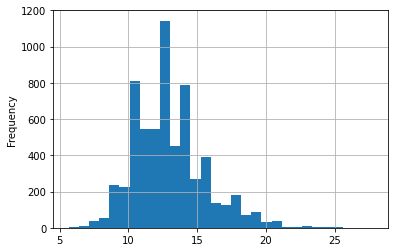

In [9]:
#wind gust assign nan when no gust. units m/s
df["wind_gust_o"]=pd.to_numeric(df["gust"], downcast="float",errors='coerce')*0.514444 

df.loc[df.wind_gust_o<0,"wind_gust_o"]="M"
#mask = (df.time > '2011-08-01') & (df.time <= '2011-11-05') & (df.wind_gust_o<0)
#df.loc[mask,["wind_gust_o","metar_o","time"]].set_index("time")
df["wind_gust_o"]=df["wind_gust_o"].fillna("M")
print(df["wind_gust_o"].describe())

pd.to_numeric(df["wind_gust_o"],downcast="float",errors="coerce").plot(kind="hist",bins=30,grid=True);

df.wind_gust_o.sample(30)

In [ ]:
import plotly.express as px
fig = px.line(df,x="time",y="wind_gust_o", title="wind_gust_o figure")
fig.show()


In [ ]:
#One hour precipitation for the period from the observation time to the time of the previous hourly precipitation reset.
#This value may or may not contain frozen precipitation melted by some device on the sensor or estimated by some other means
#transformed from inches to mm
df["prec_o"]=pd.to_numeric(df["p01i"], downcast="float",errors='coerce')*25.4
print(df["prec_o"].describe())

import plotly.express as px
fig = px.line(df,x="time",y="prec_o", title="Var figure")
fig.show()

In [11]:
#QNH in hpa
df["mslp_o"]=round(pd.to_numeric(df["alti"], downcast="float",errors='coerce')*33.8638,0)
df.loc[df.mslp_o<900,"mslp_o"]=np.nan
df.loc[df.mslp_o>1100,"mslp_o"]=np.nan
print(df["mslp_o"].describe())
print(df.loc[df["time"]=="2013-01-19 06:30:00",["mslp_o","metar"]])
print(df[["mslp_o","metar"]])

import plotly.express as px
fig = px.line(df,x="time",y="mslp_o", title="mslp_o figure")
fig.show()

count    90842.000000
mean      1018.134766
std          7.305043
min        975.000000
25%       1015.000000
50%       1019.000000
75%       1023.000000
max       1037.000000
Name: mslp_o, dtype: float64
Empty DataFrame
Columns: [mslp_o, metar]
Index: []
       mslp_o                                              metar
0      1029.0  LEST 010000Z 23009KT 200V280 9999 FEW020 SCT03...
1      1028.0  LEST 010030Z 22009KT 200V260 9999 FEW020 SCT03...
2      1028.0  LEST 010100Z 23009KT 190V260 9999 FEW020 BKN04...
3      1028.0  LEST 010130Z 22009KT 190V280 9999 FEW019 SCT04...
4      1028.0  LEST 010200Z 23009G21KT 180V290 9999 SCT015 SC...
...       ...                                                ...
90838  1015.0  LEST 302130Z 21021G35KT 170V260 9999 BKN018 14...
90839  1015.0  LEST 302200Z 21022G38KT 180V260 9999 BKN020 15...
90840  1016.0  LEST 302230Z 20019G33KT 170V260 9999 BKN018 14...
90841  1016.0  LEST 302300Z 21018G30KT 160V260 9999 -RA BKN01...
90842  1016.0  LEST 302330Z 2

In [ ]:
#Sea Level Pressure in hPa . Unknown. Data are incompletely
pd.to_numeric(df["mslp"], downcast="float",errors='coerce').describe()


count    30121.000000
mean      1017.220886
std          7.230199
min        974.299988
25%       1014.200012
50%       1018.000000
75%       1021.299988
max       1037.699951
Name: mslp, dtype: float64

       visibility_o                                              metar
86598        9994.0  LEST 081800Z 03004KT 350V080 9999 FEW017 21/16...
36521        1207.0  LEST 012353Z 18005KT 1200 0500S R17/P2000 R35/...
810          2494.0  LEST 161730Z 25007KT 200V300 2500 -DZ BCFG VV0...
80517        9994.0  LEST 071330Z 22009KT 180V290 9999 FEW020 21/14...
5930         9994.0  LEST 262230Z 28004KT 250V320 CAVOK 10/08 Q1017...
90776        8996.0  LEST 291630Z 17007KT 130V200 9000 3500E -RA BK...
79366        9994.0  LEST 151300Z 22013KT 160V260 9999 BKN022 16/12...
15263        2993.0  LEST 012130Z 24006KT 210V290 3000 -DZRA BR BKN...
47658        9994.0  LEST 141200Z VRB03KT 9999 FEW030 SCT049 21/12 ...
72490        7998.0  LEST 270000Z 25012G26KT 210V300 8000 -SHRA SCT...
63832        9994.0  LEST 050730Z 21013G24KT 170V270 9999 BKN009 BK...
20035        9994.0  LEST 051200Z 21007KT 180V240 9999 FEW009 BKN03...
13371        9994.0  LEST 241530Z 05010KT 020V100 CAVOK 22/13 Q1024...
77435 

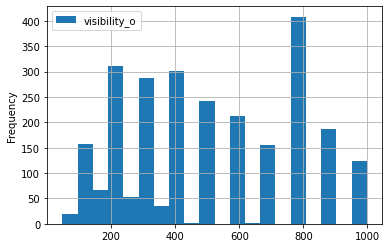

In [12]:
#visibility in meters
df["visibility_o"]=round(pd.to_numeric(df["vsby"], downcast="float",errors='coerce')*1609.344,0)
df.loc[df.visibility_o<=0,"visibility_o"]=np.nan
df.loc[df.visibility_o>9999,"visibility_o"]=9999
print(df[["visibility_o","metar"]].sample(20))
print(df["visibility_o"].describe())
df.loc[df.visibility_o<=1000,["visibility_o"]].plot(kind="hist",grid=True,bins=20);
import plotly.express as px
fig = px.line(df,x="time",y="visibility_o", title="Var figure")
fig.show()


In [13]:
#pd.to_numeric(df["skyl1"], downcast="float",errors='ignore').sample(100)
#df[["skyc1","skyl1","skyc2","skyl2","skyc3","skyl3","skyc4","skyl4","metar"]].sample(30)
df["skyc1_o"]=df["skyc1"]
df["skyc2_o"]=df["skyc2"]
df["skyc3_o"]=df["skyc3"]
df["skyl1_o"]=round(pd.to_numeric(df["skyl1"], downcast="float",errors='coerce')*0.3048,0)
df["skyl1_o"]=df.skyl1_o.fillna(-1)
df.loc[df.skyl1_o>2000,"skyl1_o"]=np.nan
df["skyl1_o"]=df["skyl1_o"].replace(-1,"M")
print(df[["skyl1_o","metar"]].describe())
print(df[["skyl1_o","metar"]].sample(30))
df["skyl2_o"]=round(pd.to_numeric(df["skyl2"], downcast="float",errors='coerce')*0.3048,0)
df["skyl2_o"]=df.skyl2_o.fillna("M")
print(df[["skyl2_o","metar"]].describe())
df["skyl3_o"]=round(pd.to_numeric(df["skyl3"], downcast="float",errors='coerce')*0.3048,0)
df["skyl3_o"]=df.skyl3_o.fillna("M")
print(df[["skyl3_o","metar"]].describe())
df["skyl4_o"]=round(pd.to_numeric(df["skyl4"], downcast="float",errors='coerce')*0.3048,0)
df["skyl4_o"]=df.skyl4_o.fillna("M")
print(df[["skyl4_o","metar"]].describe())

import plotly.express as px
fig = px.line(df,x="time",y="skyl4_o", title="Var figure")
fig.show()

       skyl1_o                                              metar
count    90801                                              90843
unique      55                                              90841
top          M  LEST 152312Z 34004KT 310V010 0700 R17/0900U R3...
freq     22578                                                  2
      skyl1_o                                              metar
83721   610.0  LEST 120030Z 09004KT 9999 FEW020 18/16 Q1017 N...
10593    91.0  LEST 300230Z 21009KT 170V260 4500 BR BKN003 OV...
33603   427.0  LEST 060500Z 24003KT 190V290 9999 4000E BCFG F...
24576   518.0  LEST 081330Z 24014G28KT 200V290 6000 SCT017 BK...
16021  1219.0  LEST 162100Z 13006KT 9999 FEW040 13/10 Q1014 N...
63077    91.0  LEST 200600Z 23006KT 190V280 9000 SCT003 BKN00...
30381       M  LEST 031130Z 12005KT 070V170 CAVOK 26/14 Q1022...
47036    61.0  LEST 020230Z 03008KT 6000 FEW002 14/13 Q1023 N...
78273    91.0  LEST 230630Z 26004KT 210V320 5000 BCFG BKN003 ...
62242   792.0  LEST 

In [14]:
#wxcodes
pd.options.display.max_rows=100
df.wxcodes.value_counts(normalize=True).map(lambda n: '{:.2%}'.format(n))
df["wxcodes_o"]=df["wxcodes"]

In [15]:
#metar
df["metar_o"]=df["metar"]

In [16]:
#last review
print(df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].info())
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90843 entries, 0 to 90842
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   time          90843 non-null  datetime64[ns]
 1   temp_o        90843 non-null  float32       
 2   tempd_o       90843 non-null  float32       
 3   rh_o          90749 non-null  float32       
 4   dir_o         90843 non-null  float32       
 5   spd_o         90843 non-null  float32       
 6   wind_gust_o   90843 non-null  object        
 7   mslp_o        90842 non-null  float32       
 8   visibility_o  90838 non-null  float32       
 9   skyc1_o       90843 non-null  object        
 10  skyc2_o       90843 non-null  object        
 11  skyc3_o       90843 non-null  object        
 12  skyl1_o       90801 non-null  object        
 13  skyl2_o       90843 non-null  object        
 14  skyl3_o       90843 non-null  object        
 15  wxcodes_o     90843 non-null  object

,temp_o,tempd_o,rh_o,dir_o,spd_o,mslp_o,visibility_o
count,90843.000000,90843.000000,90749.000000,90843.000000,90843.000000,90842.000000,90838.000000
mean,285.973480,282.809204,83.080482,142.021057,3.099021,1018.134766,8681.924805
std,5.608593,4.577136,15.661489,116.111816,2.004885,7.305043,2609.865967
min,268.000000,262.000000,14.580000,-1.000000,0.000000,975.000000,48.000000
25%,282.000000,280.000000,73.089996,20.000000,1.543332,1015.000000,8996.000000
50%,285.000000,283.000000,87.559998,140.000000,2.572220,1019.000000,9994.000000
75%,289.000000,286.000000,93.690002,240.000000,4.115552,1023.000000,9994.000000
max,310.000000,299.000000,100.000000,360.000000,15.947763,1037.000000,9994.000000


In [17]:
df=df.drop_duplicates(subset="time")

In [19]:
#save results
#from google.colab import drive
#drive.mount('/content/drive')
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].to_csv("LESTY2018Y2022.csv")

In [ ]:
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']]

,time,temp_o,tempd_o,rh_o,dir_o,spd_o,wind_gust_o,mslp_o,visibility_o,skyc1_o,skyc2_o,skyc3_o,skyl1_o,skyl2_o,skyl3_o,wxcodes_o,metar_o
0,2018-01-01 00:00:00,276.149994,275.149994,93.139999,-1.0,0.514444,M,1026.0,9994.0,NCD,M,M,M,M,M,M,LEPP 010000Z AUTO VRB01KT 9999 NCD 03/02 Q1026
1,2018-01-01 00:30:00,276.149994,274.149994,86.690002,0.0,0.000000,M,1026.0,9994.0,NCD,M,M,M,M,M,M,LEPP 010030Z AUTO 00000KT 9999 NCD 03/01 Q1026
2,2018-01-01 01:00:00,275.149994,274.149994,93.080002,70.0,3.086664,M,1026.0,9994.0,NCD,M,M,M,M,M,M,LEPP 010100Z AUTO 07006KT 9999 NCD 02/01 Q1026
3,2018-01-01 01:30:00,276.149994,273.149994,80.650002,0.0,0.000000,M,1026.0,9994.0,NCD,M,M,M,M,M,M,LEPP 010130Z AUTO 00000KT 9999 NCD 03/00 Q1026
4,2018-01-01 02:00:00,275.149994,274.149994,93.080002,-1.0,0.514444,M,1027.0,9994.0,NCD,M,M,M,M,M,M,LEPP 010200Z AUTO VRB01KT 9999 NCD 02/01 Q1027
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17687,2018-12-30 21:30:00,279.149994,271.149994,56.480000,10.0,2.057776,M,1031.0,9994.0,M,M,M,M,M,M,M,LEPP 302130Z 01004KT 320V080 CAVOK 06/M02 Q1031
17688,2018-12-30 22:00:00,278.149994,271.149994,60.540001,50.0,1.028888,M,1031.0,9994.0,M,M,M,M,M,M,M,LEPP 302200Z 05002KT CAVOK 05/M02 Q1031
17689,2018-12-30 22:30:00,277.149994,271.149994,64.930000,100.0,1.028888,M,1031.0,9994.0,M,M,M,M,M,M,M,LEPP 302230Z 10002KT CAVOK 04/M02 Q1031
17690,2018-12-30 23:00:00,276.149994,271.149994,69.669998,-1.0,1.028888,M,1031.0,9994.0,M,M,M,M,M,M,M,LEPP 302300Z VRB02KT CAVOK 03/M02 Q1031


In [ ]:
df.to_csv("LEPP2018.csv")

In [ ]:
data=collections.Counter(df["wxcodes"])
data_sorted = {k: v for k, v in sorted(data.items(), key=lambda x: x[1])}
print(data_sorted)

NameError: ignored